# Dissonance as a Cost Function of Harmonization
Kenny Huang

## Library imports

In [1]:
# Imports
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pretty_midi
import mido
import dissonant
import music21
import timeit
import mingus
import librosa
import mir_eval
import mir_eval.display
import IPython.display
import os
import random
import importlib
from IPython.display import Audio
from IPython.display import display
import sf2_loader as sf2
from tqdm import tqdm
import matplotlib.animation as animation
import utils as u
import glob
import soundfile as sf
import re

## Preprocessing

### Geting valid midi files

In [5]:
# Set a seed value for the random number generator
# If the midi_valid subset below gives an error for whatever reason, use a different seed
random.seed(11)

# Get all raw midi files in directory and sub directories``
root_dir = './clean_midi/clean_midi/'
midi_files = u.get_all_files(root_dir, '.mid')
midi_files.sort()
print(f"{len(midi_files)} midi files found in {root_dir}")

# Shuffle the list of MIDI files using the same seed value
random.shuffle(midi_files)

17257 midi files found in ./clean_midi/clean_midi/


In [6]:
midi_files[:5]

['c:\\Users\\kenny\\Desktop\\nyu\\thesis\\clean_midi\\clean_midi\\Joan Jett\\Do You Wanna Touch Me_ (Oh Yeah!).mid',
 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\clean_midi\\clean_midi\\Jackson Michael\\Heal The World.5.mid',
 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\clean_midi\\clean_midi\\Celentano\\Attraverso me.mid',
 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\clean_midi\\clean_midi\\Jovanotti\\Penso Positivo.1.mid',
 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\clean_midi\\clean_midi\\Sting\\Unplugged 02 Mad About You.mid']

In [138]:
# Take a subset of the shuffled MIDI files that have melody and are multitrack
midi_subset = u.get_valid_midi_files_with_melody_and_duration(midi_files)

100%|██████████| 17441/17441 [1:02:56<00:00,  4.62it/s]


In [143]:
# For whatever reason some files are repeated, so remove all duplicate files
midi_subset = list(set(midi_subset))
len(midi_subset)

2307

In [144]:
np.save("./valid_midi_paths.npy", midi_subset)

In [145]:
np.load("./valid_midi_paths.npy")
len(midi_subset)

2307

In [216]:
# Copy files to new directory for processing
og_midi_dst_dir = "./clean_midi/valid_midi/original/midi_full/"
new_midi_files  = u.copy_files(midi_subset, og_midi_dst_dir)

In [186]:
# Sometimes there may be some error when copying
len(new_midi_files)

2307

In [219]:
len(file_list)

2178

In [7]:
og_midi_dst_dir = "./clean_midi/valid_midi/original/midi_full/"
file_list = os.listdir(og_midi_dst_dir)
og_midi_dst_dir

'./clean_midi/valid_midi/original/midi_full/'

In [226]:
# Create an empty dictionary to store the base file names and their corresponding numeric suffixes
unique_names = {}

# Loop through all the files in the directory and remove some similar files
for filename in os.listdir(og_midi_dst_dir):
    # Use regular expressions to extract the base file name and numeric suffix, if any
    match = re.match(r"(.+)\.(\d+)\.mid", filename)
    if match:
        base_name = match.group(1)
        suffix = int(match.group(2))
    else:
        base_name = os.path.splitext(filename)[0]
        suffix = None
    # Check if the base name is already in the dictionary of unique names
    if base_name in unique_names:
        # If it is, check if this file has a numeric suffix and if it's lower than the previous one
        if suffix is not None and suffix < unique_names[base_name]:
            # If it is, replace the previous file with this one
            os.remove(os.path.join(og_midi_dst_dir, f"{base_name}.{unique_names[base_name]}.mid"))
            unique_names[base_name] = suffix
        else:
            # Otherwise, delete this file
            os.remove(os.path.join(og_midi_dst_dir, filename))
    else:
        # If it's not in the dictionary, add it with its numeric suffix, if any
        unique_names[base_name] = suffix


In [13]:
# og_midi_dst_dir = "./clean_midi/valid_midi/original/midi/"
og_midi_dst_dir = "./clean_midi/valid_midi/original/midi_full/"

### Creating audio files

In [233]:
# Creating wav files from original midi files using soundfonts (use a subset)
# Manually go into the dir to see which audio files are invalid
midi_paths          = u.get_all_files(og_midi_dst_dir, ".mid")
og_midi_wav_dst_src = './clean_midi/valid_midi/original/audio/'
# og_midi_wav_dst_src = './clean_midi/valid_midi/original/audio_full/'
soundfont_path      = './soundfont/alex_gm.sf2'
midi_wav_paths      = u.mid_to_wav(midi_paths     = midi_paths[:555],
                                   dst_src        = og_midi_wav_dst_src,
                                   soundfont_path = soundfont_path)


100%|██████████| 555/555 [1:02:46<00:00,  6.79s/it]


In [ ]:
# Checking that files from both directories match
midi_file_path = "./clean_midi/valid_midi/original/midi/"
audio_file_path = "./clean_midi/valid_midi/original/audio/"
# midi_file_path = "./clean_midi/valid_midi/original/midi_full/"
# audio_file_path = "./clean_midi/valid_midi/original/audio_full/"

# Extract the file names without extensions from both directories
dir1_filenames = {os.path.splitext(filename)[0] for filename in os.listdir(midi_file_path)}
dir2_filenames = {os.path.splitext(filename)[0] for filename in os.listdir(audio_file_path)}

# Find the file that's missing from each directory
dir1_missing = dir2_filenames - dir1_filenames
dir2_missing = dir1_filenames - dir2_filenames

# Print the results
if len(dir1_missing) == 0 and len(dir2_missing) == 0:
    print('All files in both directories have the same name (excluding file extension).')
else:
    if len(dir1_missing) > 0:
        print('The following file(s) is missing from directory 1:')
        for filename in dir1_missing:
            print(filename + '.*')
    if len(dir2_missing) > 0:
        print('The following file(s) is missing from directory 2:')
        for filename in dir2_missing:
            print(filename + '.*')

In [ ]:
og_audio_files = u.get_all_files(audio_file_path, ".wav")
og_midi_files = u.get_all_files(midi_file_path, ".mid")

In [8]:
# larger size midis
midi_file_path = "./clean_midi/valid_midi/original/midi_full/"
og_midi_files = u.get_all_files(midi_file_path, ".mid")

In [10]:
len(og_midi_files)

1745

### Removing drums

In [11]:
# Remove drums from midi files
drumless_midi_dst_dir = './clean_midi/valid_midi/drumless/midi_full/og/'
drumless_midi_subset  = u.remove_drums(og_midi_files, drumless_midi_dst_dir)

100%|██████████| 1745/1745 [12:56<00:00,  2.25it/s]


In [14]:
# Using a new variable for drumess_midi_subset to save time
drumless_midi = u.get_all_files(drumless_midi_dst_dir, '.mid')

In [17]:
# Creating wav files from drumless_midi using soundfonts
drumless_midi_wav_dst_src = './clean_midi/valid_midi/drumless/audio_full/og/'
soundfont_path            = './soundfont/alex_gm.sf2'
wavs_drumless_midi        = u.mid_to_wav(midi_paths     = drumless_midi[:555],
                                         dst_src        = drumless_midi_wav_dst_src,
                                         soundfont_path = soundfont_path)


100%|██████████| 555/555 [1:07:01<00:00,  7.25s/it]


In [18]:
len(wavs_drumless_midi)

555

In [ ]:
# Creating the CQT of the drumless tracks
drumless_cqt_dst_src = "./clean_midi/valid_midi/drumless/cqt/og"
figsize              = (16,9)
hop_length           = 4096
n_bins               = 84
bins_per_octave      = 12
window               = 'hamming'
cqt_drumless = u.audio_to_cqt(audio_paths     = wavs_drumless_midi,
                              dst_src         = drumless_cqt_dst_src,
                              figsize         = figsize,
                              hop_length      = hop_length,
                              n_bins          = n_bins,
                              bins_per_octave = bins_per_octave,
                              window          = window)

100%|██████████| 94/94 [02:55<00:00,  1.87s/it]


In [ ]:
# Setting new variable for the npy files to save time
cqt_drumless_dir = "./clean_midi/valid_midi/drumless/cqt/og/"
cqt_drumless_files = u.get_all_files(cqt_drumless_dir, '.npy')


### Trimming CQTs and audio & pairing chords

#### sample

In [19]:
# Define paths
# input_dir_midi   = "./clean_midi/valid_midi/drumless/audio/og/"
# output_dir_audio = "./clean_midi/valid_midi/trimmed_drumless/audio/og"
# output_dir_cqt   = "./clean_midi/valid_midi/trimmed_drumless/cqt/og"

# Define paths (more data)
input_dir_midi   = "./clean_midi/valid_midi/drumless/audio_full/og/"
output_dir_audio = "./clean_midi/valid_midi/trimmed_drumless/audio_full/og"
output_dir_cqt   = "./clean_midi/valid_midi/trimmed_drumless/cqt_full/og"

# Create the output directories if they don't exist
os.makedirs(output_dir_audio, exist_ok=True)
os.makedirs(output_dir_cqt, exist_ok=True)

trimmed_audios = []
trimmed_cqts = []
# Iterate over all files in the input directory
for filename in tqdm(os.listdir(input_dir_midi)):
    # Check if the file is a WAV file
    if filename.endswith('.wav'):
        # Build the full path to the file
        file_path = os.path.join(input_dir_midi, filename)
        
        # Load the audio file and compute the trimmed audio and CQT
        start_time = 30.0
        duration = 30.0         # trimmed duration of each audio
        hop_length = 512
        n_bins = 12 * 7         # 7 octaves from C1 to C8
        bins_per_octave = 12
        window = 'hann'
        pth, audio_trimmed, sr, cqt_trimmed = u.trim_audio_with_cqt_normalized(file_path=file_path,
                                                                               start_time=start_time,
                                                                               duration=duration,
                                                                               hop_length=hop_length,
                                                                               n_bins=n_bins,
                                                                               bins_per_octave=bins_per_octave,
                                                                               window=window)
        # Adding to the empty lists
        trimmed_audios.append(audio_trimmed)
        trimmed_cqts.append(cqt_trimmed)

        # Build the output file paths for the trimmed audio and CQT
        output_audio_path = os.path.join(output_dir_audio, filename.replace('.wav', '_trimmed.wav'))
        output_cqt_path = os.path.join(output_dir_cqt, filename.replace('.wav', '_trimmed.png'))

        # Save the trimmed audio and CQT to their respective output directories
        sf.write(output_audio_path, audio_trimmed, sr)
        np.save(output_cqt_path.replace('.png', '.npy'), cqt_trimmed)

        # # Creating plot with no axis
        # fig = plt.figure()
        # ax = fig.add_subplot(111)
        # ax.axis("off")

        # # Display the CQT on the figure
        # librosa.display.specshow(cqt_trimmed, sr=sr, hop_length=hop_length, y_axis='cqt_note', bins_per_octave=bins_per_octave, ax=ax)
        
        # # Save the figure to a file
        # plt.savefig(output_cqt_path, dpi=600, bbox_inches='tight', pad_inches=0, format='png')
        # plt.close()

100%|██████████| 555/555 [06:59<00:00,  1.32it/s]


In [27]:
# Plot and play a sample
sample_midi_audio = "./clean_midi/valid_midi/trimmed_drumless/audio/og/All That She Want's.3_drumless_trimmed.wav"
cqt_dir = "./clean_midi/valid_midi/trimmed_drumless/cqt/og/"

# Find the matching CQT plot
dir_path, file_name_ext = os.path.split(sample_midi_audio)
file_name, ext = os.path.splitext(file_name_ext)
sample_midi_cqt = os.path.join(cqt_dir, file_name + '.npy')
sample_trimmed_cqt = np.load(sample_midi_cqt)

In [ ]:
sample_trimmed_cqt.shape

(84, 2584)

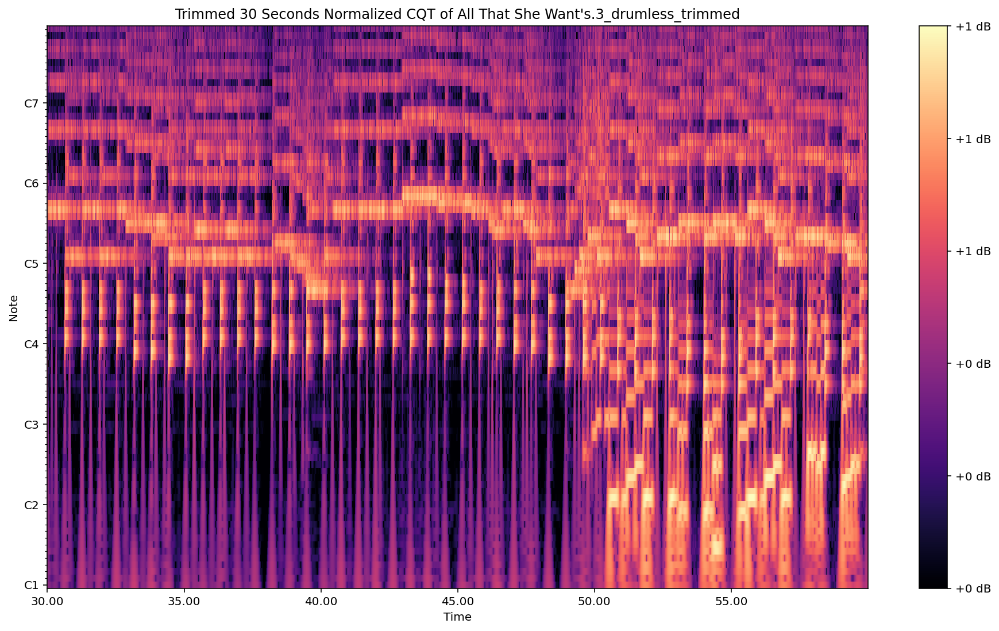

In [28]:
# Display sample CQT and play the audio
sr = 44100
hop_length = 512
start_time = 30
duration = 30

# Compute the trimmed time values
frame_times_trimmed = librosa.frames_to_time(np.arange(sample_trimmed_cqt.shape[1]), sr=sr, hop_length=hop_length) + start_time

# Set up the plot
fig, ax = plt.subplots(figsize=(16,9))
cqt_plot = librosa.display.specshow(sample_trimmed_cqt,
                         sr=sr, x_axis='time', y_axis='cqt_note',
                         x_coords=frame_times_trimmed)

plt.colorbar(format='%+2.0f dB')
plt.title(f'Trimmed {duration} Seconds Normalized CQT of {file_name}')

# Set the xaxis tick format to non-scientific notation
xaxis = plt.gca().xaxis
xaxis.set_major_formatter(plt.FormatStrFormatter('%.2f'))

# Play the trimmed audio
display(Audio(sample_midi_audio))

In [120]:
importlib.reload(u)

<module 'utils' from 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\utils.py'>

In [147]:
ys, srs = librosa.load("./clean_midi/valid_midi/trimmed_drumless/audio/og/All That She Want's.3_drumless_trimmed.wav")
windows_ = u.window_audio(ys, srs, 1, 0.5)

100%|██████████| 60/60 [00:00<00:00, 56337.19it/s]


In [171]:
# Segment the audio into windows
audio_windows = u.window_audio(ys, srs, audio_seg_size=1, segments_overlap=0.5)

# Define chord intervals in seconds and chord labels
chord_intervals = np.load("./clean_midi/valid_midi/trimmed_drumless/chord_labels/og/All That She Want's.3_drumless_trimmed_intervals.npy")
chord_labels = np.load("./clean_midi/valid_midi/trimmed_drumless/chord_labels/og/All That She Want's.3_drumless_trimmed_labels.npy")

# Create an empty NumPy array with the same length as the number of windows
chord_labels_array = np.empty(len(audio_windows))

# Iterate over the windows and assign a chord label to each one
for i, window in enumerate(audio_windows):
    start_time = i * (1 - 0.5)  # Calculate the start time of the window
    end_time = start_time + 1  # Calculate the end time of the window

    # Find the chord label that corresponds to the current window
    for j, interval in enumerate(chord_intervals):
        if start_time >= interval[0] and end_time <= interval[1]:
            chord_label = chord_labels[j]
            break

    # Assign the chord label to the corresponding index in the array
    chord_labels_array[i] = chord_label

100%|██████████| 60/60 [00:00<00:00, 60147.76it/s]


100%|██████████| 60/60 [00:00<00:00, 60176.53it/s]


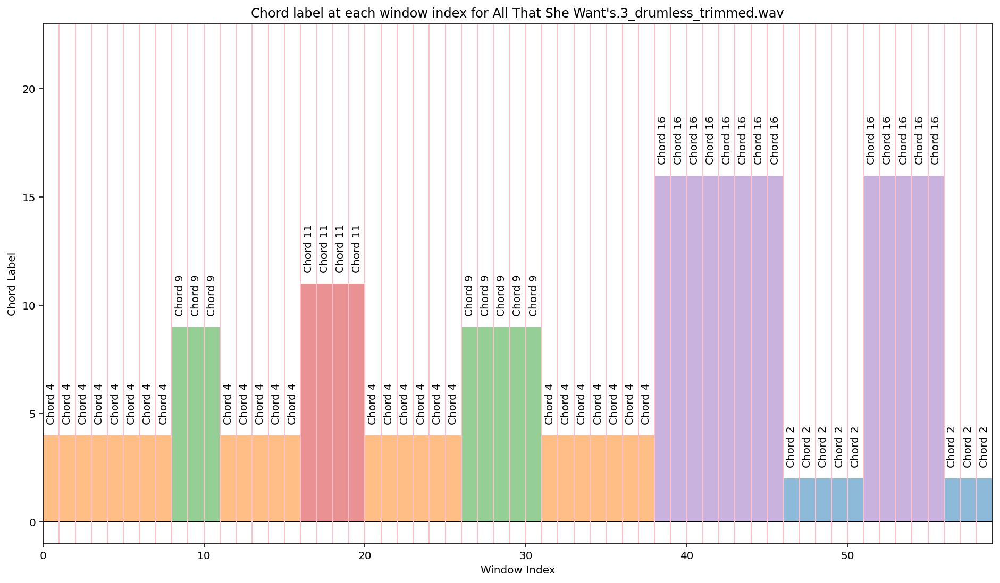

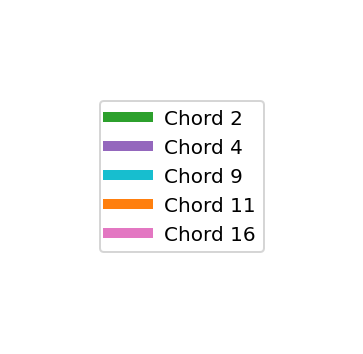

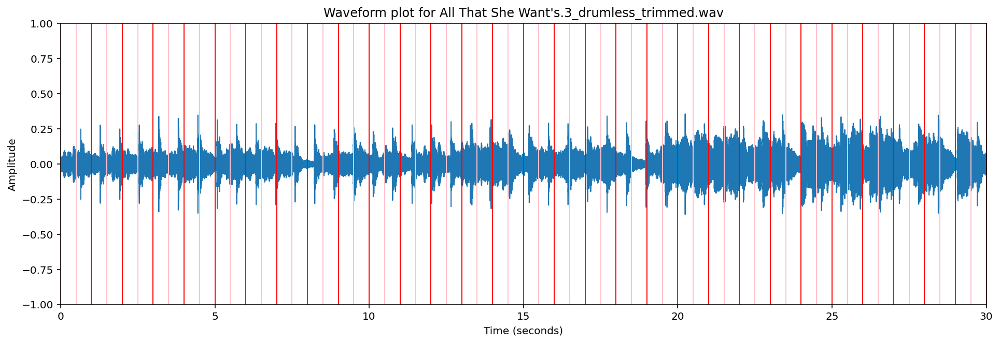

In [28]:
# Sample plot of chord labels for each window of audio / cqt
sample_audio = "./clean_midi/valid_midi/trimmed_drumless/audio/og/All That She Want's.3_drumless_trimmed.wav"
pth, fn = os.path.split(sample_audio)
ys, srs = librosa.load(sample_audio, sr=None)


# Segment the audio into windows
audio_windows = u.window_audio(ys, srs, audio_seg_size=1, segments_overlap=0.5)

# Define chord intervals in seconds and chord labels
chord_intervals = np.load("./clean_midi/valid_midi/trimmed_drumless/chord_labels/og/All That She Want's.3_drumless_trimmed_intervals.npy")
chord_labels = np.load("./clean_midi/valid_midi/trimmed_drumless/chord_labels/og/All That She Want's.3_drumless_trimmed_labels.npy")

# Create an empty NumPy array with the same length as the number of windows
chord_labels_array = np.empty(len(audio_windows))

# Iterate over the windows and assign a chord label to each one
for i, window in enumerate(audio_windows):
    start_time = i * (1 - 0.5)  # Calculate the start time of the window
    end_time = start_time + 1  # Calculate the end time of the window

    # Find the chord label that corresponds to the current window
    for j, interval in enumerate(chord_intervals):
        if start_time >= interval[0] and end_time <= interval[1]:
            chord_label = chord_labels[j]
            break

    # Assign the chord label to the corresponding index in the array
    chord_labels_array[i] = chord_label

# Create the main plot
fig, ax = plt.subplots(figsize=(16, 9))

# Plot the chord labels as a filled area
unique_labels = np.unique(chord_labels_array)
for label in unique_labels:
    mask = (chord_labels_array == label)
    ax.fill_between(np.arange(len(audio_windows)), mask.astype(float) * label, step='pre', alpha=0.5)

    for i, val in enumerate(mask):
        if val and i > 0:  # Only add labels from the second window onwards
            ax.text(i-0.5, label+0.5, f'Chord {int(label)}', rotation=90, ha='center', va='bottom')

# Plot the windows as a line and add vertical lines at each window index
ax.plot(np.arange(len(audio_windows)), np.zeros(len(audio_windows)), color='black', lw=1)
ax.vlines(np.arange(len(audio_windows)), -1, 23, color='pink', lw=1)

# Set the x and y labels
ax.set_xlabel('Window Index')
ax.set_ylabel('Chord Label')

# Set the y limits to the range of the chord labels
ax.set_xlim([0, len(audio_windows)-1])
ax.set_ylim([-1, 23])
ax.set_title(f"Chord label at each window index for {fn}")

# Create the legend plot
fig_legend, ax_legend = plt.subplots(figsize=(3, 3))
handles = []
for label in unique_labels:
    handles.append(ax_legend.plot([], [], color='C'+str(int(label)), linewidth=5, label='Chord '+str(int(label)))[0])
ax_legend.legend(handles=handles, loc='center')
ax_legend.axis('off')

# Create the waveform plot and add vertical lines at each window index
fig, ax2 = plt.subplots(figsize=(16, 5))
librosa.display.waveshow(ys, sr=srs, ax=ax2)
# Plot the windows as a line and add vertical lines at each window index
# ax2.plot(np.arange(len(audio_windows)), np.zeros(len(audio_windows)), color='black', lw=1)
ax2.vlines(np.arange(len(audio_windows)), -1, 23, color='red', lw=1)
ax2.vlines(np.arange(0.5, len(audio_windows)), -1, 23, color='pink', lw=1)

# Set the x and y labels
ax2.set_xlabel('Time (seconds)')
ax2.set_ylabel('Amplitude')
ax2.set_title(f"Waveform plot for {fn}")

# Set the x limits to the range of the audio duration
ax2.set_xlim([0, len(ys)/srs])

# Set the y limits to the same range as the chord label plot
ax2.set_ylim([-1, 1])

# Display both plots
plt.show()

In [277]:
chord_labels_array

array([ 4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,  9.,  9.,  9.,  4.,
        4.,  4.,  4.,  4., 11., 11., 11., 11.,  4.,  4.,  4.,  4.,  4.,
        4.,  9.,  9.,  9.,  9.,  9.,  4.,  4.,  4.,  4.,  4.,  4.,  4.,
       16., 16., 16., 16., 16., 16., 16., 16.,  2.,  2.,  2.,  2.,  2.,
       16., 16., 16., 16., 16.,  2.,  2.,  2.])

In [79]:
importlib.reload(u)

<module 'utils' from 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\utils.py'>

In [29]:
sample_slices = u.window_cqt_normalized("./clean_midi/valid_midi/trimmed_drumless/audio/og/All That She Want's.3_drumless_trimmed.wav",
                             hop_length=512, n_bins=84, bins_per_octave=12, window='hann', fmin=librosa.note_to_hz('C1'))

In [77]:
sample_slices[-1].shape

(84, 87)

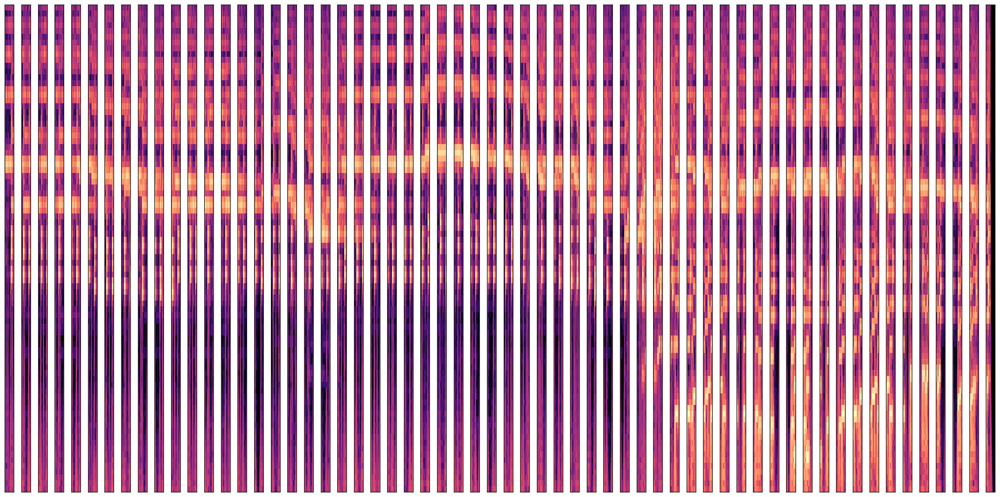

In [32]:
# plot first few slice
srs = 44100
fig, axs = plt.subplots(nrows=1, ncols=60, figsize=(20, 10))

for i, ax in enumerate(axs):
    librosa.display.specshow(sample_slices[i], sr=srs, ax=ax)
    # ax.set_title(f"CQT slice {i+1}")
    # ax.set_xlabel("Time")
    # ax.set_ylabel("Frequency")
    # plt.colorbar(ax=ax)

plt.tight_layout()
plt.show()

In [84]:
importlib.reload(u)

<module 'utils' from 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\utils.py'>

In [24]:
# # Path to the directory containing audio files
# audio_dir = './clean_midi/valid_midi/trimmed_drumless/audio/og/'

# # Path to the directory containing labels and intervals
# labels_dir = './clean_midi/valid_midi/trimmed_drumless/chord_labels/og/'

# more data
# Path to the directory containing audio files
audio_dir = './clean_midi/valid_midi/trimmed_drumless/audio_full/og/'

# Path to the directory containing labels and intervals
labels_dir = './clean_midi/valid_midi/trimmed_drumless/chord_labels_full/og/'

cqt_slices_list = []
chord_labels_list = []
# Loop over all files in the directory
for file in tqdm(os.listdir(audio_dir)):
    # Check if the file is an audio file
    if file.endswith('.wav'):
        # Create the path to the file
        file_path = os.path.join(audio_dir, file)
        # Compute the CQT slices for the file
        cqt_slices = u.window_cqt_normalized(file_path)
        # Append the CQT slices to the list
        cqt_slices_list.append(cqt_slices)
        
        # Load the chord intervals and labels for the file
        intervals_path = os.path.join(labels_dir, file[:-4] + '_intervals.npy')
        labels_path = os.path.join(labels_dir, file[:-4] + '_labels.npy')
        chord_intervals = np.load(intervals_path)
        chord_labels = np.load(labels_path)
        
        # Create an empty NumPy array with the same length as the number of windows
        chord_labels_array = np.empty(len(cqt_slices))
        
        # Iterate over the windows and assign a chord label to each one
        for i, window in enumerate(cqt_slices):
            start_time = i * (1 - 0.5)  # Calculate the start time of the window
            end_time = start_time + 1  # Calculate the end time of the window

            # Find the chord label that corresponds to the current window
            for j, interval in enumerate(chord_intervals):
                if start_time >= interval[0] and end_time <= interval[1]:
                    chord_label = chord_labels[j]
                    break

            # Assign the chord label to the corresponding index in the array
            chord_labels_array[i] = chord_label
        
        # Append the chord labels to the list
        chord_labels_list.append(chord_labels_array)

100%|██████████| 555/555 [34:56<00:00,  3.78s/it]


In [25]:
# # saving the input cqt slices for the cnn
# np.save("./cqt_slices_list.npy", cqt_slices_list)
# np.save("./chord_labels_list.npy", chord_labels_list)

# saving the input cqt slices for the cnn
np.save("./cqt_slices_list_full.npy", cqt_slices_list)
np.save("./chord_labels_list_full.npy", chord_labels_list)

In [26]:
# load npy file
# shape is (num_files, num_windows per file, num_freq_bins, window_length)
cqt_slices_arr = np.load("./cqt_slices_list_full.npy")
chord_labels_arr = np.load("./chord_labels_list_full.npy")
print(cqt_slices_arr.shape)
print(chord_labels_arr.shape)

(555, 60, 84, 87)
(555, 60)


### Predicting trimmed audio chord labels and intervals

In [22]:
# # Define paths
# audio_path = './clean_midi/valid_midi/trimmed_drumless/audio/og/'
# intervals_dir = './clean_midi/valid_midi/trimmed_drumless/chord_labels/og/'
# labels_dir = './clean_midi/valid_midi/trimmed_drumless/chord_labels/og/'

# more data
# Define paths
audio_path = './clean_midi/valid_midi/trimmed_drumless/audio_full/og/'
intervals_dir = './clean_midi/valid_midi/trimmed_drumless/chord_labels_full/og/'
labels_dir = './clean_midi/valid_midi/trimmed_drumless/chord_labels_full/og/'

# Create the output directories if they don't exist
os.makedirs(intervals_dir, exist_ok=True)
os.makedirs(labels_dir, exist_ok=True)

# Loop over audio files path and estimate chords
for file_name in tqdm(os.listdir(audio_path)):
    if file_name.endswith('.wav'):
        # Load audio file
        audio_file = os.path.join(audio_path, file_name)
        
        # Estimate chords
        chord_intervals, chord_labels = u.estimate_chords(audio_file)

        # Convert chord labels to numbers
        chord_labels = [u.chord_to_number(chord) for chord in chord_labels]

        # Save chord intervals and labels
        intervals_file = os.path.join(intervals_dir, file_name.replace('.wav', '_intervals.npy'))
        labels_file = os.path.join(labels_dir, file_name.replace('.wav', '_labels.npy'))
        
        np.save(intervals_file, chord_intervals)
        np.save(labels_file, chord_labels)

100%|██████████| 555/555 [01:30<00:00,  6.10it/s]


In [34]:
# Loading sample trimmed audio
trimmed_sample = "./clean_midi/valid_midi/trimmed_drumless/audio/og/All That She Want's.3_drumless_trimmed.wav"
y, sr = librosa.load(trimmed_sample, sr=None)
predicted_intervals, predicted_labels = u.estimate_chords(trimmed_sample)

# predicted chords sonification
predicted_chords = mir_eval.sonify.chords(predicted_labels, predicted_intervals, sr)
if (len(predicted_chords) < len(y)):     # appending zeros to predicted_chords if length less than y
    predicted_chords = np.append(predicted_chords, np.zeros(len(y) - len(predicted_chords)))
elif (len(predicted_chords) > len(y)):   # appending zeros to y if length less than predicted_chords
    y = np.append(y, np.zeros(len(predicted_chords) - len(y)))

predicted_chords_no_audio = 0.2*predicted_chords
predicted_chords_with_audio = np.vstack((0.2*predicted_chords, y))
print(predicted_chords_with_audio.shape)
predicted_chords_no_audio_player = IPython.display.Audio(predicted_chords_no_audio, rate=sr)
predicted_chords_with_audio_player = IPython.display.Audio(predicted_chords_with_audio, rate=sr)
predicted_chords_with_audio_mono_player = IPython.display.Audio(predicted_chords_no_audio + y, rate=sr)

print(f"Predicted chords:")
IPython.display.display(predicted_chords_no_audio_player)

print(f"Predicted chords with audio:")
IPython.display.display(predicted_chords_with_audio_player)

print(f"Predicted chords with audio (mono):")
IPython.display.display(predicted_chords_with_audio_mono_player)

(2, 1323000)
Predicted chords:


Predicted chords with audio:


Predicted chords with audio (mono):


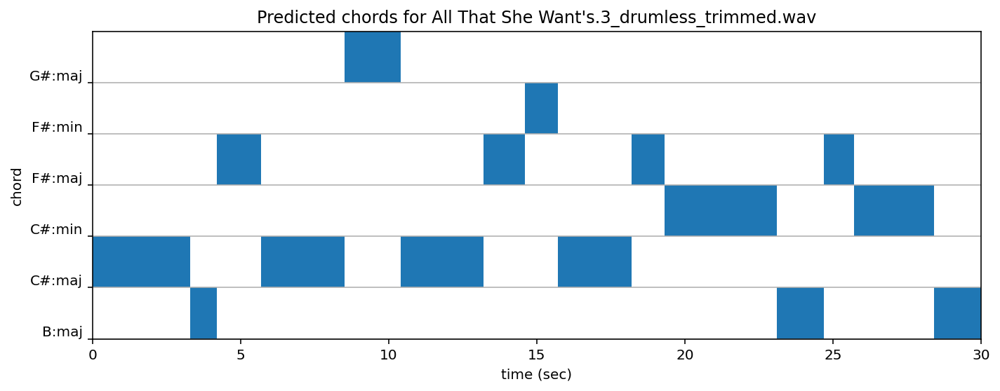

In [35]:
# predicted chords plot
dir_path, file_name_ext = os.path.split(trimmed_sample)
fig, ax = plt.subplots(figsize=(10,4))
label_set = sorted(list(set(predicted_labels)))
mir_eval.display.labeled_intervals(predicted_intervals, predicted_labels, label_set, ax=ax)
ax.set(title=f'Predicted chords for {file_name_ext}')
ax.set(ylabel='chord')
ax.set(xlabel='time (sec)')
plt.tight_layout()

In [ ]:
# chromagram of audio is inaccurate, probably better to do chromagram of midi

In [36]:
# # Confirm the labels are saved correctly
# chord_labels_dir = "./clean_midi/valid_midi/trimmed_drumless/chord_labels/og/"

# more data
# Confirm the labels are saved correctly
chord_labels_dir = "./clean_midi/valid_midi/trimmed_drumless/chord_labels_full/og/"

# Find matching chord labels and intervals
dir_path, file_name_ext = os.path.split(trimmed_sample)
file_name, ext = os.path.splitext(file_name_ext)
sample_midi_labels = os.path.join(chord_labels_dir, file_name + '_labels' + '.npy')
sample_midi_intervals = os.path.join(chord_labels_dir, file_name + '_intervals' + '.npy')
sample_trimmed_labels = np.load(sample_midi_labels)
sample_trimmed_intervals = np.load(sample_midi_intervals)

In [37]:
sample_trimmed_intervals

array([[ 0. ,  3.3],
       [ 3.3,  4.2],
       [ 4.2,  5.7],
       [ 5.7,  8.5],
       [ 8.5, 10.4],
       [10.4, 13.2],
       [13.2, 14.6],
       [14.6, 15.7],
       [15.7, 18.2],
       [18.2, 19.3],
       [19.3, 23.1],
       [23.1, 24.7],
       [24.7, 25.7],
       [25.7, 28.4],
       [28.4, 30. ]])

In [38]:
predicted_intervals

array([[ 0. ,  3.3],
       [ 3.3,  4.2],
       [ 4.2,  5.7],
       [ 5.7,  8.5],
       [ 8.5, 10.4],
       [10.4, 13.2],
       [13.2, 14.6],
       [14.6, 15.7],
       [15.7, 18.2],
       [18.2, 19.3],
       [19.3, 23.1],
       [23.1, 24.7],
       [24.7, 25.7],
       [25.7, 28.4],
       [28.4, 30. ]])

In [39]:
predicted_labels

['C#:maj',
 'B:maj',
 'F#:maj',
 'C#:maj',
 'G#:maj',
 'C#:maj',
 'F#:maj',
 'F#:min',
 'C#:maj',
 'F#:maj',
 'C#:min',
 'B:maj',
 'F#:maj',
 'C#:min',
 'B:maj']

In [ ]:
sample_trimmed_labels

array(['C#:maj', 'B:maj', 'F#:maj', 'C#:maj', 'G#:maj', 'C#:maj',
       'F#:maj', 'F#:min', 'C#:maj', 'F#:maj', 'C#:min', 'B:maj',
       'F#:maj', 'C#:min', 'B:maj'], dtype='<U6')

In [6]:
# Load MIDI file
midi_data = pretty_midi.PrettyMIDI("./clean_midi/valid_midi/drumless/midi/og/All That She Want's.3_drumless.mid")

# Define intervals
intervals = np.array([[ 0. ,  3.3],
                      [ 3.3,  4.2],
                      [ 4.2,  5.7],
                      [ 5.7,  8.5],
                      [ 8.5, 10.4],
                      [10.4, 13.2],
                      [13.2, 14.6],
                      [14.6, 15.7],
                      [15.7, 18.2],
                      [18.2, 19.3],
                      [19.3, 23.1],
                      [23.1, 24.7],
                      [24.7, 25.7],
                      [25.7, 28.4],
                      [28.4, 30.]])

# Initialize lists to store notes and velocities for each interval
all_notes = []
all_velocities = []

# Iterate over intervals
for i, interval in enumerate(intervals):
    start_time = interval[0] + 30.0
    end_time = interval[1] + 30.0

    # Get notes for each instrument in the interval
    notes = []
    velocities = []
    for instrument in midi_data.instruments:
        for note in instrument.notes:
            if start_time <= note.start < end_time:
                notes.append(note.pitch)
                velocities.append(note.velocity)

    # Add notes and velocities to lists
    all_notes.append(notes)
    all_velocities.append(velocities)

    # print(f"Interval {i}: {start_time:.1f} to {end_time:.1f} seconds")
    # print("Notes:", notes)
    # print("Velocities:", velocities)

Interval 0: 30.0 to 33.3 seconds
Notes: [80, 80, 73, 73, 80, 80, 73, 73, 80, 78, 78, 61, 65, 68, 61, 65, 68, 65, 68, 61, 65, 61, 68, 63, 59, 66]
Velocities: [69, 100, 67, 87, 94, 103, 90, 77, 103, 94, 90, 106, 127, 106, 113, 127, 103, 127, 97, 106, 127, 103, 106, 127, 113, 113]
Interval 1: 33.3 to 34.2 seconds
Notes: [78, 76, 78, 63, 59, 66]
Velocities: [94, 76, 103, 127, 118, 103]
Interval 2: 34.2 to 35.7 seconds
Notes: [76, 73, 73, 77, 73, 58, 61, 66, 61, 58, 66, 65, 61, 68]
Velocities: [77, 100, 97, 113, 84, 122, 113, 87, 127, 127, 97, 127, 106, 94]
Interval 3: 35.7 to 38.5 seconds
Notes: [73, 73, 77, 73, 73, 75, 65, 61, 68, 65, 61, 68, 68, 61, 65, 60, 63, 68]
Velocities: [92, 74, 106, 92, 84, 87, 127, 106, 100, 122, 103, 94, 106, 106, 127, 103, 85, 80]
Interval 4: 38.5 to 40.4 seconds
Notes: [75, 73, 72, 70, 68, 73, 60, 63, 68, 60, 63, 68, 60, 63, 68]
Velocities: [94, 78, 80, 82, 110, 78, 110, 90, 82, 110, 90, 85, 113, 127, 103]
Interval 5: 40.4 to 43.2 seconds
Notes: [80, 80, 80, 

In [20]:
n = all_notes[1]
v = all_velocities[1]

In [21]:
v

[94, 76, 103, 127, 118, 103]

In [23]:
hz_values

[739.9888454232688,
 659.2551138257398,
 739.9888454232688,
 311.1269837220809,
 246.94165062806206,
 369.9944227116344]

In [26]:
# Convert MIDI values to frequencies
hz_values = [u.midi_to_hz(m) for m in [100, 200, 400]]

# Generate harmonic tone for each velocity
profile = 'exp'
freqs, amps = dissonant.harmonic_tone(base_freqs=hz_values, n_partials=5, profile=profile)

# Normalizing amplitude to be between 0 and 1: n * (127*(amps[0][0])) = 1
normalize_factor = 1 / (amps[0][0] * 127)

# Multiply velocities by amps
velocity_np = np.array([100, 100, 100])
amps = np.multiply(velocity_np[:, np.newaxis], amps)
amps = amps * normalize_factor

# Calculate dissonance
d = dissonant.dissonance(freqs, amps, model='sethares1993')
d
    

4.489449509004765e-05

In [10]:
# Loop through all the tracks to get the dissonance of each measure of each track
all_values = []         # for chord identification
all_dissonance = []     # for calculating dissonance
for track in tqdm(notes_by_measure):
    values = []
    velocities = []
    for measure in track:
        temp_values = []
        temp_velocities = []
        for item in measure:
            temp_values.append(item[0])
            if len(item) > 1:
                temp_velocities.append(item[1])
        values.append(temp_values)
        velocities.append(temp_velocities)
    
    # Appending to all_values
    all_values.append(values)

    # Replacing empty arrays with np.nan values
    values = [[np.nan] if not x else x for x in values]
    velocities = [[np.nan] if not x else x for x in velocities]

    dissonance = []
    # Iterate through values and velocities
    for i in range(len(values)):
        value = values[i]
        velocity = velocities[i]

        # For all np.nan values replace with -1 (events with no note events will have a -1 dissonance)
        if np.isnan(value).any() or np.isnan(velocity).any():
            dissonance.append(-1)
            continue

        # Convert MIDI values to frequencies
        hz_values = [u.midi_to_hz(m) for m in value]

        # Generate harmonic tone for each velocity
        profile = 'exp'
        freqs, amps = dissonant.harmonic_tone(base_freqs=hz_values, n_partials=5, profile=profile)

        # Normalizing amplitude to be between 0 and 1: n * (127*(amps[0][0])) = 1
        normalize_factor = 1 / (amps[0][0] * 127)

        # Multiply velocities by amps
        velocity_np = np.array(velocity)
        amps = np.multiply(velocity_np[:, np.newaxis], amps)
        amps = amps * normalize_factor

        # Calculate dissonance
        d = dissonant.dissonance(freqs, amps, model='sethares1993')
        dissonance.append(d)
    
    # Appending to all_dissonance
    all_dissonance.append(dissonance)



[69,
 100,
 67,
 87,
 94,
 103,
 90,
 77,
 103,
 94,
 90,
 106,
 127,
 106,
 113,
 127,
 103,
 127,
 97,
 106,
 127,
 103,
 106,
 127,
 113,
 113]

### Trimming CQT to fixed duration and combine respective labels

In [ ]:
# testing
chord_labels_dir = "./clean_midi/valid_midi/trimmed_drumless/chord_labels/og/"
sample_cqt_file = "./clean_midi/valid_midi/trimmed_drumless/cqt/og/Ballroom Dancing_drumless_trimmed.npy"

# Find matching chord labels and intervals given cqt file
dir_path, file_name_ext = os.path.split(sample_cqt_file)
file_name, ext = os.path.splitext(file_name_ext)
sample_midi_labels = os.path.join(chord_labels_dir, file_name + '_labels' + '.npy')
sample_midi_intervals = os.path.join(chord_labels_dir, file_name + '_intervals' + '.npy')
sample_trimmed_labels = np.load(sample_midi_labels)
sample_trimmed_intervals = np.load(sample_midi_intervals)

In [ ]:
np.load(sample_cqt_file).shape[1]

2584

In [ ]:
importlib.reload(u)

<module 'utils' from 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\utils.py'>

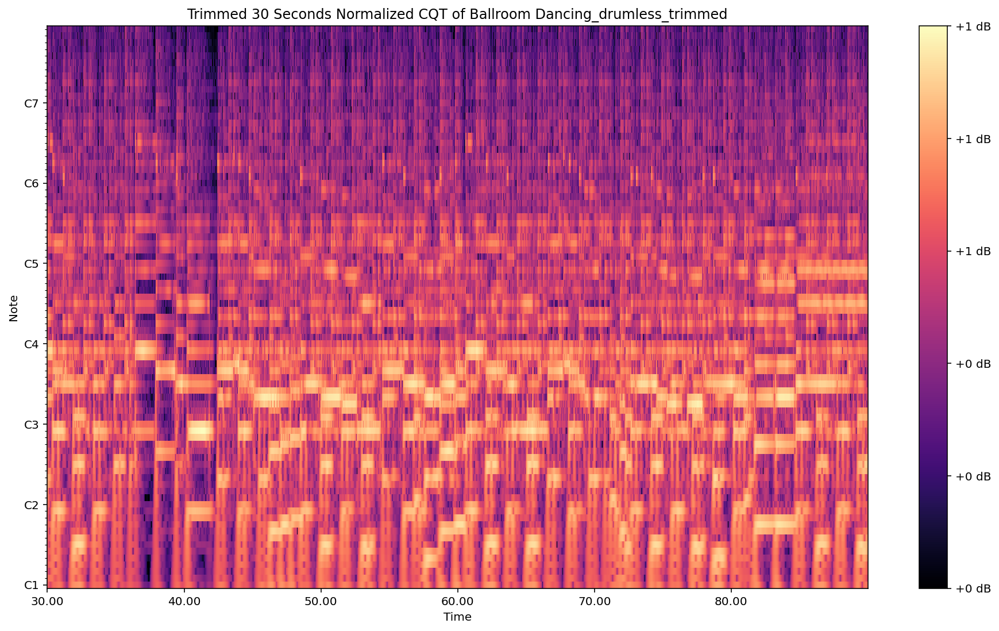

In [ ]:
# Compute the trimmed time values
sf = 44100
hop_length = 512
start_time = 30
duration = 30
cqt = np.load(sample_cqt_file)

frame_times_trimmed = librosa.frames_to_time(np.arange(cqt.shape[1]), sr=sr, hop_length=hop_length) + start_time

# Set up the plot
fig, ax = plt.subplots(figsize=(16,9))
cqt_plot = librosa.display.specshow(np.load(sample_cqt_file),
                         sr=sr, x_axis='time', y_axis='cqt_note',
                         x_coords=frame_times_trimmed)

plt.colorbar(format='%+2.0f dB')
plt.title(f'Trimmed {duration} Seconds Normalized CQT of {file_name}')

# Set the xaxis tick format to non-scientific notation
xaxis = plt.gca().xaxis
xaxis.set_major_formatter(plt.FormatStrFormatter('%.2f'))

In [ ]:
cqt.shape

(84, 2584)

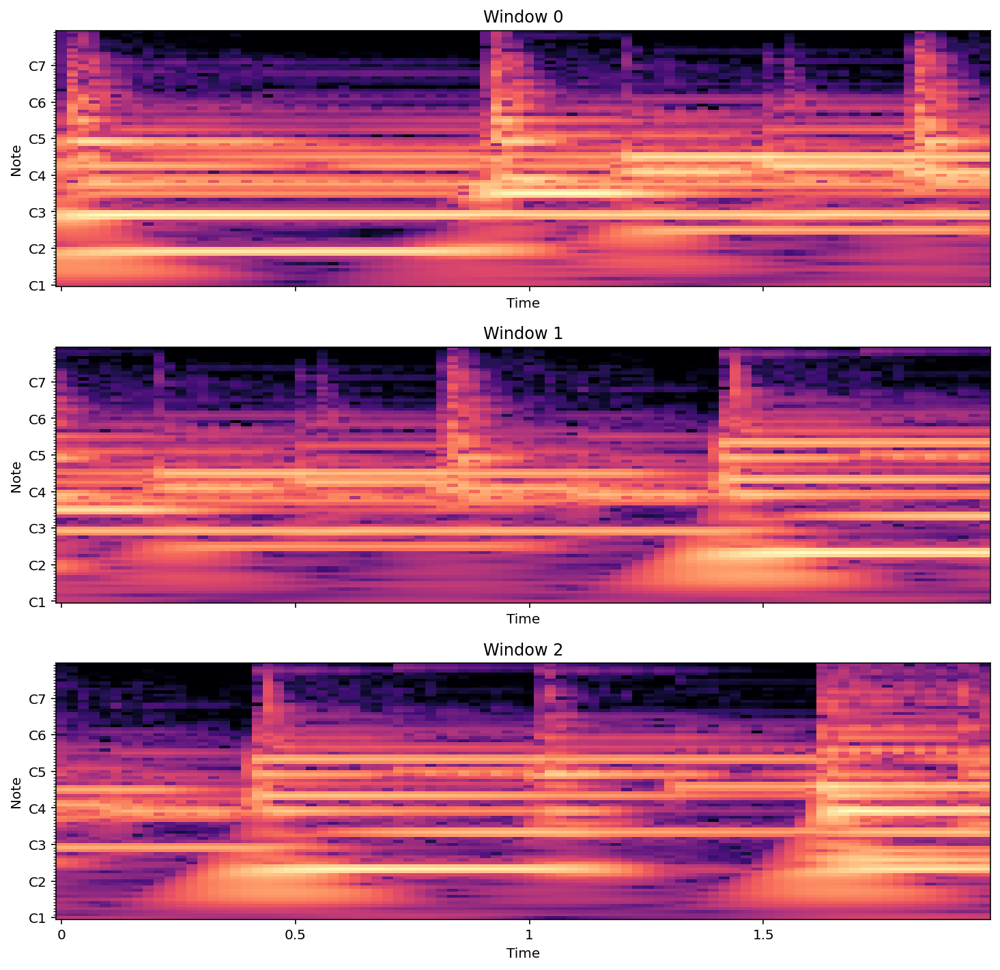

In [ ]:
# Define window size and overlap
cqt_seg_size = 1 # in seconds
overlap = 0.5 # as a fraction of window size

# Generate CQT windows
cqt_windows = u.window_cqt(np.load(sample_cqt_file), 44100, cqt_seg_size, overlap)

# # Plot the first three windows
fig, axs = plt.subplots(nrows=3, sharex=True, sharey=True, figsize=(10,10))
for i in range(3):
    axs[i].set_title(f'Window {i}')
    librosa.display.specshow(cqt_windows[i], sr=sr, x_axis='time', y_axis='cqt_note', ax=axs[i])
plt.tight_layout()
plt.show()

In [ ]:
cqt_windows[0].shape

(84, 86)

In [ ]:
len(cqt_windows)

61

In [ ]:
cqt_windows = u.assign_chords_to_cqt(np.load(sample_cqt_file), sample_trimmed_intervals, sample_trimmed_labels, 0.1, 0.5)


KeyboardInterrupt: 

In [ ]:
cqt_windows[0][2].shape

(46600,)

In [ ]:
chord_labels_windows

[array([[0., 1.]])]

### Scrap

<ipython-input-113-32be6241f3df>:12: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(cqt), sr=sample_rate, x_axis='time', y_axis='cqt_note')


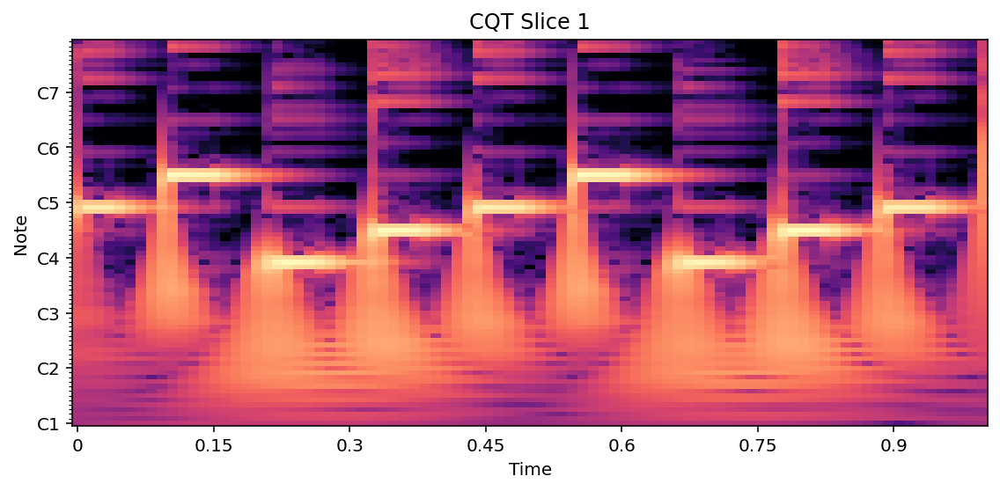

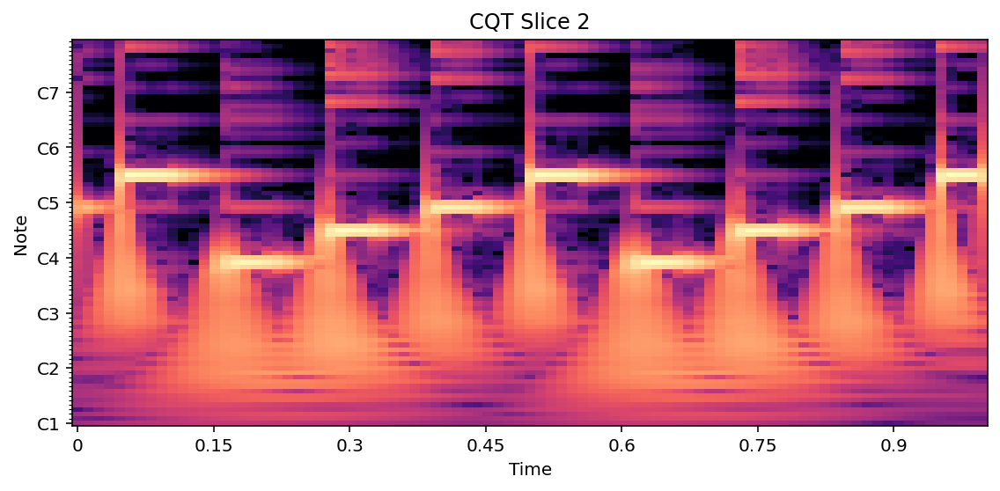

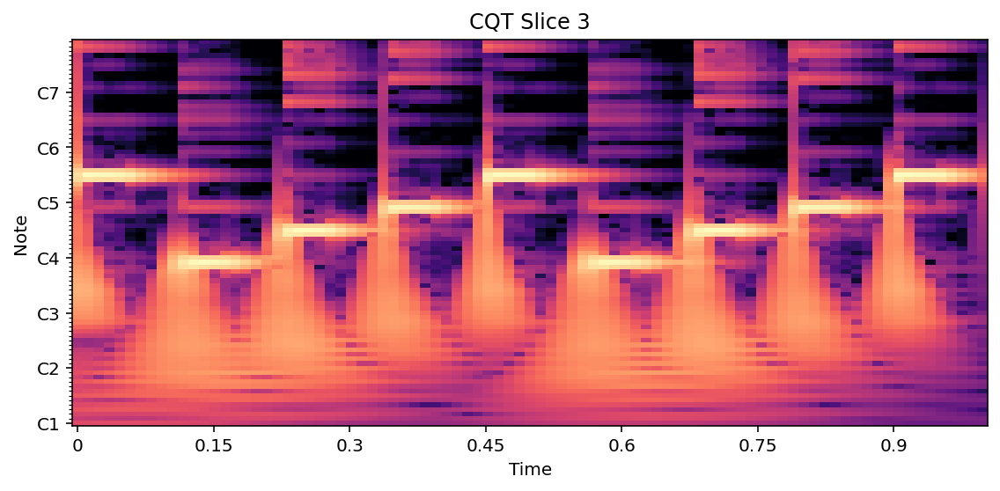

In [ ]:
# Plotting CQT slices
# Load audio file
audio, sample_rate = librosa.load('./test000.wav', sr=None)

# Segment the audio signal into windows
audio_windows = u.window_audio(audio, sample_rate, audio_seg_size=1, segments_overlap=0.5)

# Compute the CQT of each window and display them
for i, window in enumerate(audio_windows[5:8]):
    cqt = librosa.cqt(window, sr=sample_rate)
    plt.figure(figsize=(8, 4))
    librosa.display.specshow(librosa.amplitude_to_db(cqt), sr=sample_rate, x_axis='time', y_axis='cqt_note')
    plt.title('CQT Slice {}'.format(i+1))
    # plt.colorbar(format='%+2.0f dB')
    plt.tight_layout()
    plt.show()


In [ ]:
len(audio_windows)

522

In [ ]:
duration = len(audio) / float(sample_rate)

print('Duration of audio:', duration, 'seconds')

Duration of audio: 260.7469841269841 seconds


In [ ]:
# Load the audio file
y, sr = librosa.load("./clean_midi/valid_midi/drumless/audio/Come mai (feat. Fiorello).1_drumless.wav")

# Compute the CQT
cqt = librosa.cqt(y, sr=sr)

# Compute the time values
frame_times = librosa.frames_to_time(np.arange(cqt.shape[1]), sr=sr)

# Determine the start and end time of the duration you want to trim from the middle of the audio file
duration = 30 # seconds
middle_time = len(y) / 2 / sr
start_time = int(np.round(middle_time - duration / 2) * sr)
end_time = int(np.round(middle_time + duration / 2) * sr)

# Find the indices of the CQT frames corresponding to the start and end times
start_idx = np.searchsorted(frame_times, start_time/sr)
end_idx = np.searchsorted(frame_times, end_time/sr)

# Trim the CQT array to the desired duration
cqt_trimmed = cqt[:, start_idx:end_idx]

# Play the trimmed audio
Audio(y[start_time:end_time], rate=sr)

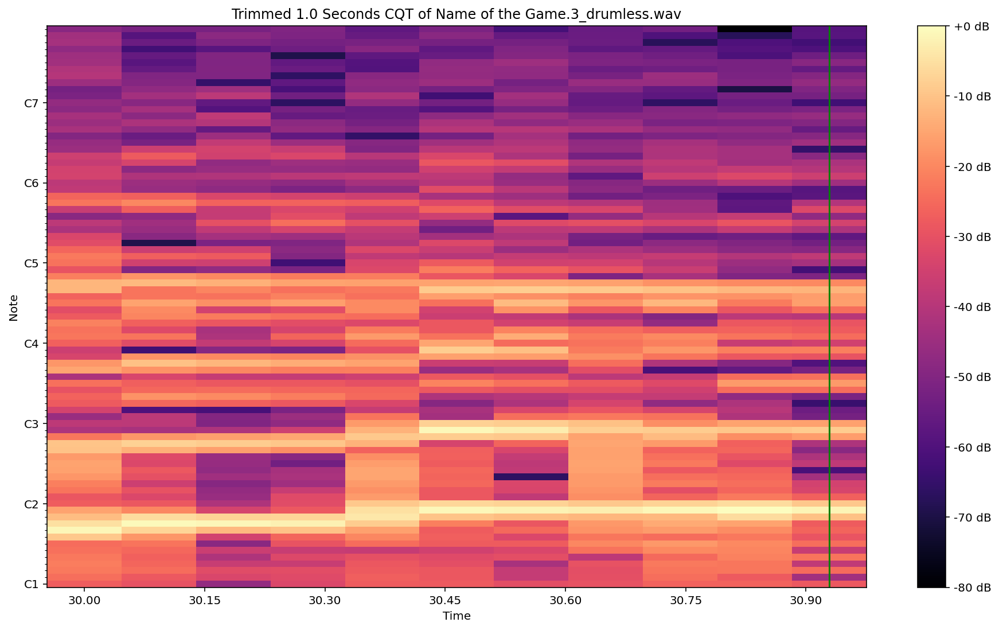

In [ ]:
# Load the audio file and compute the trimmed audio and CQT
file_path = './clean_midi/valid_midi/drumless/audio/Name of the Game.3_drumless.wav'
start_time = 30.0
duration = 1.0
pth, audio_trimmed, sr, cqt_trimmed = u.trim_audio_with_cqt(file_path, start_time, duration)

# Compute the trimmed time values
frame_times_trimmed = librosa.frames_to_time(np.arange(cqt_trimmed.shape[1]), sr=sr, hop_length=4096) + start_time

# Set up the plot
fig, ax = plt.subplots(figsize=(16, 9))
cqt_plot = librosa.display.specshow(librosa.amplitude_to_db(cqt_trimmed, ref=np.max),
                         sr=sr, x_axis='time', y_axis='cqt_note',
                         x_coords=frame_times_trimmed)
plt.colorbar(format='%+2.0f dB')
plt.title(f'Trimmed {duration} Seconds CQT of {os.path.basename(pth)}')

# Set the xaxis tick format to non-scientific notation
xaxis = plt.gca().xaxis
xaxis.set_major_formatter(plt.FormatStrFormatter('%.2f'))

# Create the vertical line
vline = ax.axvline(frame_times_trimmed[0], color='green')

# Define the animation function
def animate(i, vline):
    # Compute the frame index for the current time
    time = (i / total_frames) * duration + start_time
    frame_index = int((time - start_time) * sr / 4096)
    
    # Update the position of the vertical line
    vline.set_xdata([frame_times_trimmed[frame_index], frame_times_trimmed[frame_index]])
    
    return vline,

# Set up the animation parameters
num_frames = cqt_trimmed.shape[1]
fps = 30
total_frames = int(duration * fps)
interval = 1000 / fps

# Set up the animation
ani = animation.FuncAnimation(fig, animate, frames=total_frames, interval=interval, blit=True, fargs=(vline,))

# Save the animation as an mp4 video
Writer = animation.writers['ffmpeg']
writer = Writer(fps=fps, metadata=dict(artist=''), bitrate=1800)
ani.save('animation.mp4', writer=writer)

# Play the trimmed audio
display(Audio(audio_trimmed, rate=sr))

In [ ]:
# import soundfile as sf

# # Save the trimmed audio as a WAV file
# sf.write("audio_trimmed.wav", audio_trimmed, sr)

In [ ]:
# Combine the audio and video together
# !ffmpeg -i "animation.mp4" -i "audio_trimmed.wav" -c:v copy -c:a aac -map 0:v:0 -map 1:a:0 -shortest "animation_with_audio.mp4"


^C


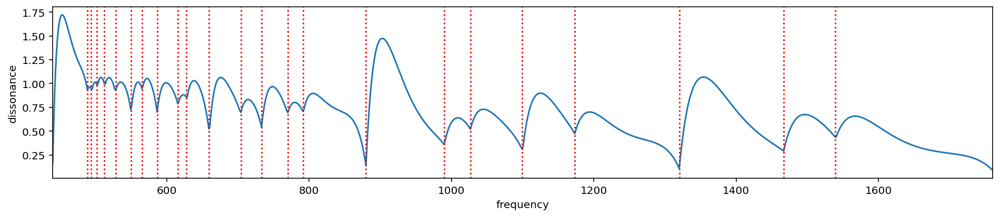

In [ ]:
# credits to https://github.com/bzamecnik/dissonant
from dissonant import harmonic_tone, dissonance, pitch_to_freq, freq_to_pitch
from scipy.signal import argrelmin

def freq_space(base_f=440, octaves=4, steps=1000):
    ratios = np.linspace(1, octaves, steps)
    freqs = base_f * ratios
    return freqs

def dissonance_curve(freq_space, n_partials=10, model='sethares1993'):
    dissonances = []
    for freq in freq_space:
        h_freqs, h_amps = harmonic_tone([freq_space[0], freq], n_partials=n_partials)
        d = dissonance(h_freqs, h_amps, model=model)
        dissonances.append(d)
    dissonances = np.array(dissonances)
    return dissonances

def plot_dissonance_curve(freqs, dissonances):
    minima = argrelmin(dissonances)[0]

    plt.figure(figsize=(16, 3))
    plt.xlim(freqs[0], freqs[-1])
    plt.plot(freqs, dissonances)
    for m in minima:
        plt.axvline(freqs[m], c='r', ls=':')
    plt.xlabel('frequency')
    plt.ylabel('dissonance')

freqs = freq_space()
plot_dissonance_curve(freqs, dissonance_curve(freqs, n_partials=10, model='vassilakis2001'))


In [ ]:
# Mingus
from mingus.containers import NoteContainer
import mingus.core.chords as chords

In [ ]:
sample_path = "./clean_midi/valid_midi/original/audio/All That She Want's.3.wav"
y, fs = librosa.load(sample_path, sr=None)
predicted_intervals, predicted_labels = u.estimate_chords(sample_path)

In [ ]:
# notes_by_measure[i]       is the (value, velocity) of the i'th midi song
# notes_by_measure[i][j]    is the (value, velocity) of the j'th measure of the i'th midi song
# notes_by_measure[i][j][k] is the (value, velocity) of the k'th note of the j'th measure of the i'th midi song
# len(notes_by_measure[i])  is the total number of measures of the i'th midi song
notes_by_measure[0]


In [ ]:
len(notes_by_measure[0])

82

In [ ]:
freq_arr = []
for lst in notes_by_measure[0]:
    if lst:
        for sublist in lst:
            if sublist:
                freq_arr.append(sublist[0])


In [ ]:
type(notes_by_measure)

list

In [ ]:
result = []
for lst in notes_by_measure[0]:
    if lst:
        sublist_result = []
        for sublist in lst:
            if sublist:
                sublist_result.append(sublist[0])
        result.append(sublist_result)

In [ ]:
# Loop through all the tracks to get the dissonance of each measure of each track
all_values = []         # for chord identification
all_dissonance = []     # for calculating dissonance
for track in tqdm(notes_by_measure):
    values = []
    velocities = []
    for measure in track:
        temp_values = []
        temp_velocities = []
        for item in measure:
            temp_values.append(item[0])
            if len(item) > 1:
                temp_velocities.append(item[1])
        values.append(temp_values)
        velocities.append(temp_velocities)
    
    # Appending to all_values
    all_values.append(values)

    # Replacing empty arrays with np.nan values
    values = [[np.nan] if not x else x for x in values]
    velocities = [[np.nan] if not x else x for x in velocities]

    dissonance = []
    # Iterate through values and velocities
    for i in range(len(values)):
        value = values[i]
        velocity = velocities[i]

        # For all np.nan values replace with -1 (events with no note events will have a -1 dissonance)
        if np.isnan(value).any() or np.isnan(velocity).any():
            dissonance.append(-1)
            continue

        # Convert MIDI values to frequencies
        hz_values = [u.midi_to_hz(m) for m in value]

        # Generate harmonic tone for each velocity
        profile = 'exp'
        freqs, amps = dissonant.harmonic_tone(base_freqs=hz_values, n_partials=5, profile=profile)

        # Normalizing amplitude to be between 0 and 1: n * (127*(amps[0][0])) = 1
        normalize_factor = 1 / (amps[0][0] * 127)

        # Multiply velocities by amps
        velocity_np = np.array(velocity)
        amps = np.multiply(velocity_np[:, np.newaxis], amps)
        amps = amps * normalize_factor

        # Calculate dissonance
        d = dissonant.dissonance(freqs, amps, model='sethares1993')
        dissonance.append(d)
    
    # Appending to all_dissonance
    all_dissonance.append(dissonance)


100%|██████████| 77/77 [02:00<00:00,  1.56s/it]


In [ ]:
len(all_values)

77

In [ ]:
# midi_drumless_files[0] = notes_by_measure[0]
pm_drumless = pretty_midi.PrettyMIDI(midi_drumless_files[-1])

# Checking both have the same shape
print(pm_drumless.get_downbeats().shape[0], len(notes_by_measure[-1]))

93 93


In [ ]:
# Mingus
from mingus.containers import NoteContainer
import mingus.core.chords as chords
'''
Triads: ‘m’, ‘M’ or ‘’, ‘dim’.
Sevenths: ‘m7’, ‘M7’, ‘7’, ‘m7b5’, ‘dim7’, ‘m/M7’ or ‘mM7’
Augmented chords: ‘aug’ or ‘+’, ‘7#5’ or ‘M7+5’, ‘M7+’, ‘m7+’, ‘7+’
Suspended chords: ‘sus4’, ‘sus2’, ‘sus47’, ‘sus’, ‘11’, ‘sus4b9’ or ‘susb9’
Sixths: ‘6’, ‘m6’, ‘M6’, ‘6/7’ or ‘67’, 6/9 or 69
Ninths: ‘9’, ‘M9’, ‘m9’, ‘7b9’, ‘7#9’
Elevenths: ‘11’, ‘7#11’, ‘m11’
Thirteenths: ‘13’, ‘M13’, ‘m13’
Altered chords: ‘7b5’, ‘7b9’, ‘7#9’, ‘67’ or ‘6/7’
Special: ‘5’, ‘NC’, ‘hendrix’

'''

# Convert to Mingus notation
all_notes = []
for outer_lst in all_values:
    # if not outer_list:
    #     continue
    new_outer_lst = []
    for inner_lst in outer_lst:
        if not inner_lst:
            new_inner_lst = [np.nan]
        else:
            new_inner_lst = [u.midi_to_note_name(midi_num) for midi_num in inner_lst]
        new_outer_lst.append(new_inner_lst)
    all_notes.append(new_outer_lst)

# track = notes_by_measure[-1]
chords = all_notes[-1]
chord  = NoteContainer(chords[3])
# a = 
m2n = chord.determine([chords[3]])
# n = NoteContainer(chord[0])



In [ ]:
chord.determine(['F#', 'G#', 'E', 'C#', 'B', 'D#'])

[]

In [ ]:
chords[3]

['F#', 'F#', 'G#', 'E', 'C#', 'B', 'D#']

In [ ]:
chord[3]

['F#-4', 'F#-4', 'G#-4', 'E-4', 'C#-4', 'B-3', 'D#-4']

In [ ]:
all_cqt_npy = u.get_all_files('./clean_midi/valid_midi/drumless/cqt/', '.npy')

In [ ]:
all_cqt = []
for cqt_npy in all_cqt_npy:
    np_cqt_npy = np.load(cqt_npy)
    all_cqt.append(np_cqt_npy)

In [ ]:
# Convert list to numpy array
all_dissonance = np.array(all_dissonance)

# Save array as npy file
np.save('./clean_midi/valid_midi/drumless/all_dissonance.npy', all_dissonance)

In [ ]:
midi_data.get_piano_roll()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [ ]:
metadata

{'path': 'c:\\Users\\kenny\\Desktop\\nyu\\thesis\\clean_midi\\clean_midi\\.38 Special\\Caught Up In You.mid',
 'tempo': 239.37499999999974,
 'time_signature': TimeSignature(numerator=4, denominator=4, time=0.0),
 'key_signature': KeySignature(key_number=0, time=0.0),
 'beats': array([  0.,   2.,   4.,   6.,   8.,  10.,  12.,  14.,  16.,  18.,  20.,
         22.,  24.,  26.,  28.,  30.,  32.,  34.,  36.,  38.,  40.,  42.,
         44.,  46.,  48.,  50.,  52.,  54.,  56.,  58.,  60.,  62.,  64.,
         66.,  68.,  70.,  72.,  74.,  76.,  78.,  80.,  82.,  84.,  86.,
         88.,  90.,  92.,  94.,  96.,  98., 100., 102., 104., 106., 108.,
        110., 112., 114., 116., 118., 120., 122., 124., 126., 128., 130.,
        132., 134., 136., 138., 140., 142., 144., 146., 148., 150., 152.,
        154., 156., 158., 160., 162., 164., 166., 168., 170., 172., 174.,
        176., 178., 180., 182., 184., 186.])}

In [ ]:
histo = midi_data.get_pitch_class_histogram(use_duration=True, use_velocity=True)

<BarContainer object of 12 artists>

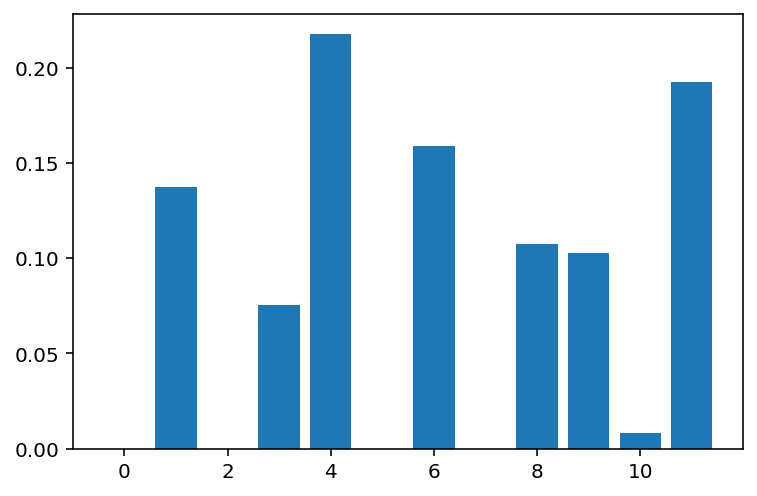

In [ ]:
plt.bar(range(12),histo)

In [ ]:
def plot_chromagram(chroma_data, tempo, time_signature):
    """
    Plot a chromagram heatmap given chromagram data and the duration of the audio in beats.

    Parameters:
    chroma_data (numpy.ndarray): Chromagram data, as returned by `get_chroma()` method of a midi file object.
    duration_seconds (int): Duration of the audio in beats.

    Returns:
    None
    """
    # Calculate duration of each beat in seconds
    beat_duration = 60 / tempo

    # Calculate duration of each bar in seconds
    bar_duration = beat_duration * time_signature[0]

    # Create time axis in seconds
    time_axis = np.arange(chroma_data.shape[1]) * beat_duration
    bar_ticks = np.arange(0, time_axis[-1], bar_duration)
    bar_tick_labels = np.arange(1, len(bar_ticks) + 1)

    # Normalize data to be between 0 and 1
    chroma_data = chroma_data / np.max(chroma_data)

    # Create heatmap plot with flipped axes
    plt.imshow(chroma_data, aspect='auto', origin='lower', cmap='gray_r', extent=[0, time_axis[-1], 0, chroma_data.shape[0]])

    # Set y-axis tick labels
    plt.yticks(np.arange(12), ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B'])
    
    # Set axis labels and title
    plt.xlabel('Time (beats)')
    plt.ylabel('Pitch Class')
    plt.title('Chromagram')

    # Show the plot
    plt.show()

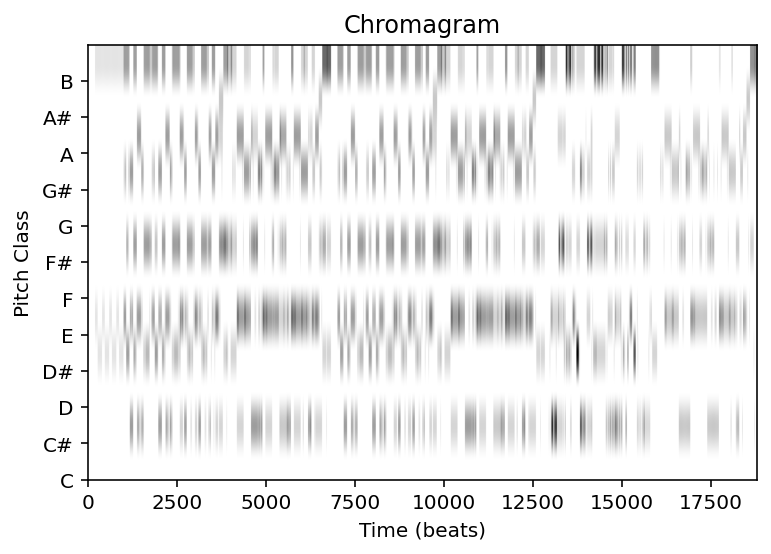

In [ ]:

# Example chromagram data
chroma_data = midi_data.get_chroma()

# Normalize data to be between 0 and 1
chroma_data = chroma_data / np.max(chroma_data)

# Create heatmap plot with flipped axes
plt.imshow(chroma_data, aspect='auto', origin='lower', cmap='gray_r', extent=[0, chroma_data.shape[1], 0, chroma_data.shape[0]])

# Set y-axis tick labels
plt.yticks(np.arange(12), ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B'])

# Set axis labels and title
plt.xlabel('Time (beats)')
plt.ylabel('Pitch Class')
plt.title('Chromagram')

# Show the plot
plt.show()

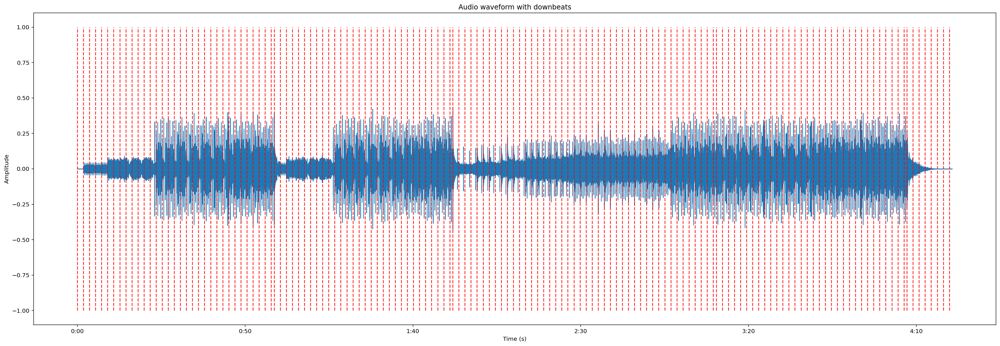

In [ ]:
import librosa.display
# Load MIDI file
midi_data = pretty_midi.PrettyMIDI(midi_files[556])

# Get downbeats
downbeats = midi_data.get_downbeats()

# Load audio
y, fs = librosa.load('./test000.wav', sr=None)

# Compute time axis
# t = librosa.times_like(y, sr=fs)

# Plot audio waveform with downbeats as vertical lines
plt.figure(figsize=(30, 10))
librosa.display.waveshow(y, sr=fs)
plt.vlines(downbeats, -1, 1, color='r', alpha=0.8, linestyle='--')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.title('Audio waveform with downbeats')
plt.show()

In [ ]:
import sounddevice as sd
# Create stereo audio array with two channels
stereo_audio = np.zeros((2, len(y)))
stereo_audio[0] = y

# Generate a sine wave beep at 440 Hz with a duration of 0.5 seconds
beep_duration = 0.03  # Duration of the beep in seconds
beep_frequency = 1000  # Frequency of the beep in Hz
beep_samples = int(beep_duration * fs)  # Number of samples in the beep
beep = np.sin(2*np.pi*beep_frequency*np.arange(beep_samples)/fs) * 0.1

# Add the beep to the second channel at downbeat times
for downbeat in downbeats:
    beep_start = int(downbeat * fs)
    stereo_audio[1, beep_start:beep_start+beep_samples] += beep[:len(y)-beep_start]

# Normalize the stereo audio
max_amplitude = np.max(np.abs(stereo_audio))
if max_amplitude > 1.0:
    stereo_audio /= max_amplitude

# Play the stereo audio
sd.play(stereo_audio.T, fs)  # Transpose to switch the channels

In [ ]:
sd.stop()

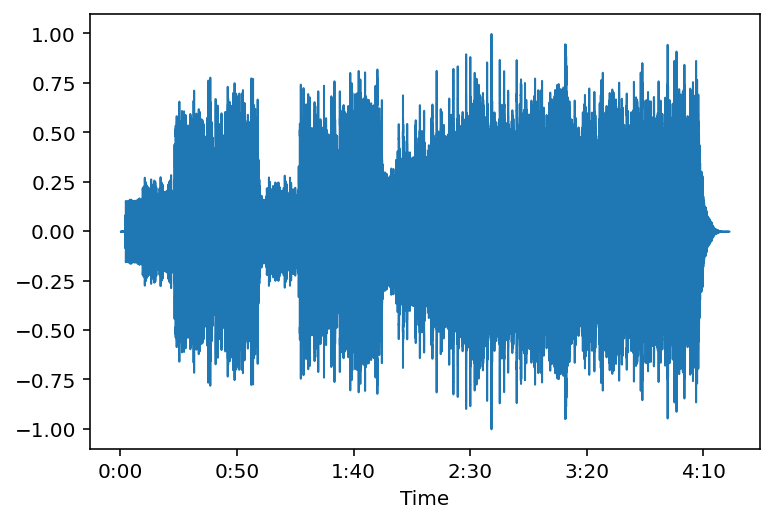

In [ ]:
mfile = midi_data.fluidsynth(44100, './soundfont/FluidR3_GM.sf2')
librosa.display.waveshow(mfile, sr=44100)

<ipython-input-154-721909065805>:14: UserWarning: amplitude_to_db was called on complex input so phase information will be discarded. To suppress this warning, call amplitude_to_db(np.abs(S)) instead.
  librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max), sr=fs, hop_length=512, x_axis='time', y_axis='cqt_note', cmap=cmap)


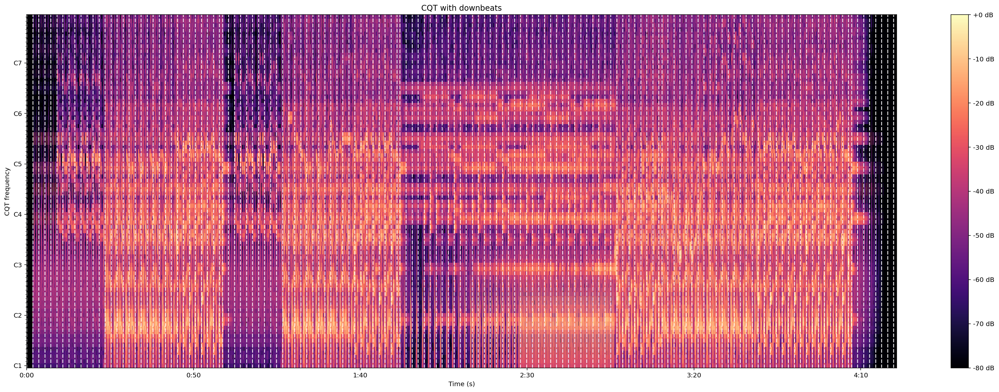

In [ ]:
# Compute CQT
C = librosa.cqt(y, sr=fs, hop_length=512)

# Compute time axis for CQT
t_cqt = librosa.times_like(C, sr=fs, hop_length=512)

# Get downbeats
midi_data = pretty_midi.PrettyMIDI(a[1])
downbeats = midi_data.get_downbeats()

# Plot CQT with downbeats as vertical lines
plt.figure(figsize=(30, 10))
cmap = plt.get_cmap('magma')
librosa.display.specshow(librosa.amplitude_to_db(C, ref=np.max), sr=fs, hop_length=512, x_axis='time', y_axis='cqt_note', cmap=cmap)
for beat in downbeats:
    plt.axvline(x=beat, ymin=0, ymax=1, color='w', alpha=0.8, linestyle='--')
plt.xlabel('Time (s)')
plt.ylabel('CQT frequency')
plt.title('CQT with downbeats')
plt.colorbar(format='%+2.0f dB')
plt.show()

In [ ]:
# Load the MIDI file
test_file = midi_subset[5]
midi_name = os.path.basename(test_file)
midi_data = pretty_midi.PrettyMIDI(test_file)

print(f"Name: {midi_name}")

# Print the tempo of the MIDI file
print(f"Tempo: {round(int(midi_data.get_tempo_changes()[1]))}")

# Print the number of time signature changes in the MIDI file
print(f"Number of time signature changes: {len(midi_data.time_signature_changes)}")

# Print the number of instruments in the MIDI file
print(f"Number of instruments: {len(midi_data.instruments)}")

Name: Dreadlock Holiday.2.mid
Tempo: 103
Number of time signature changes: 1
Number of instruments: 11


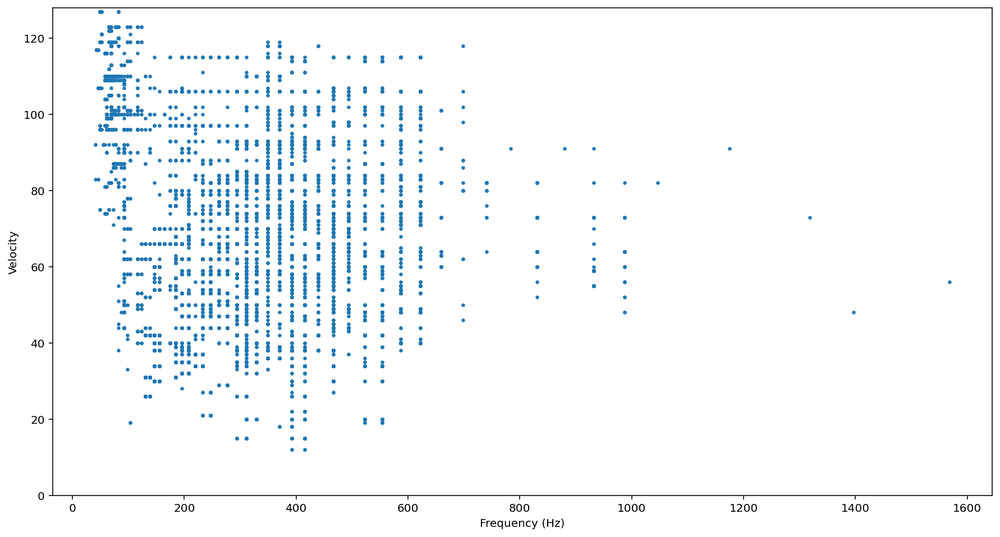

In [ ]:
# Load the MIDI file
midi_data = pretty_midi.PrettyMIDI(midi_with_melody[0])

# Define an empty list to hold the note frequencies and velocities
note_freqs = []
note_velocities = []

# Loop over each instrument in the MIDI file
for instrument in midi_data.instruments:
    # Loop over each note in the instrument
    for note in instrument.notes:
        # Append the note frequency and velocity to the lists
        note_freqs.append(pretty_midi.note_number_to_hz(note.pitch))
        note_velocities.append(note.velocity)

# Create a scatter plot of note frequencies and velocities
fig, ax = plt.subplots(figsize=(15, 8))
ax.scatter(note_freqs, note_velocities, s=5)

# Set the x-axis and y-axis labels and limits
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Velocity')
# ax.set_xlim(0, 8000)
ax.set_ylim(0, 128)

# Show the plot
plt.show()




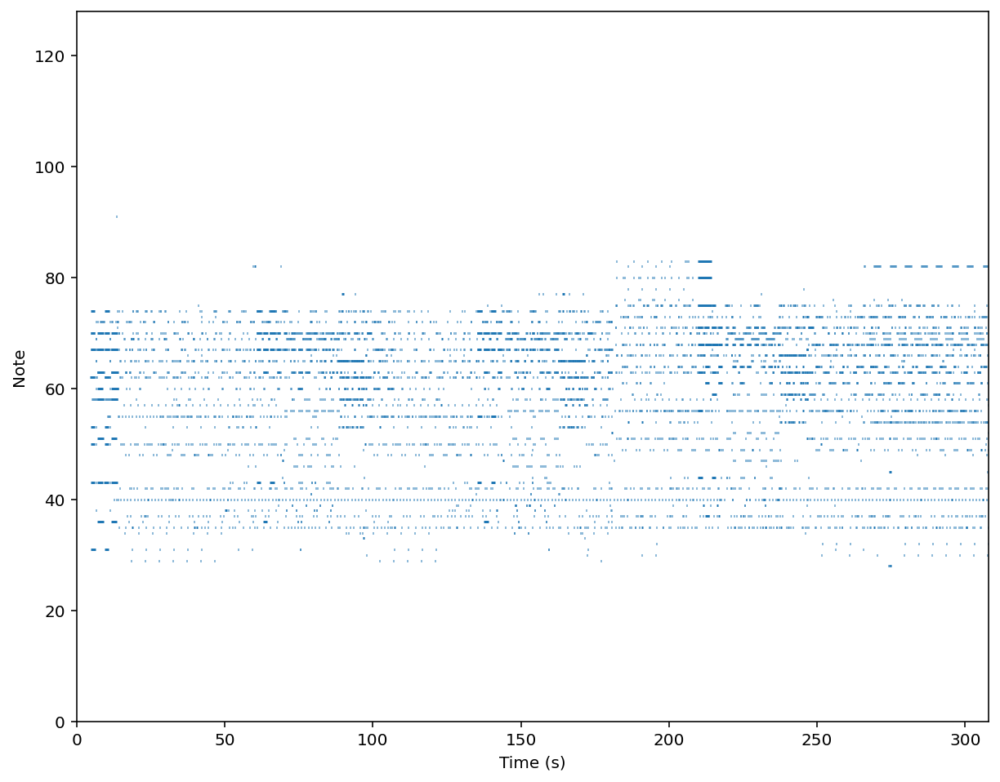

In [ ]:
# Load the MIDI file
midi_data = pretty_midi.PrettyMIDI(midi_with_melody[0])

# Define an empty list to hold the note start times, end times, and pitches
note_starts = []
note_ends = []
note_pitches = []

# Loop over each instrument in the MIDI file
for instrument in midi_data.instruments:
    # Loop over each note in the instrument
    for note in instrument.notes:
        # Append the note start time, end time, and pitch to the lists
        note_starts.append(note.start)
        note_ends.append(note.end)
        note_pitches.append(note.pitch)

# Create a new figure
fig, ax = plt.subplots(figsize=(10, 8))

# Plot each note as a horizontal line with its start time on the x-axis
for start, end, pitch in zip(note_starts, note_ends, note_pitches):
    ax.hlines(y=pitch, xmin=start, xmax=end)

# Set the x-axis and y-axis labels and limits
ax.set_xlabel('Time (s)')
ax.set_ylabel('Note')
ax.set_xlim(0, midi_data.get_end_time())
ax.set_ylim(0, 128)

# Show the plot
plt.show()

## Deep Learning

### Loading the data

In [ ]:
# Run this in google colab
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.utils import to_categorical

# Load the data
cqt_slices_arr = np.load("/content/drive/MyDrive/cqt_slices_list.npy")
chord_labels_arr = np.load("/content/drive/MyDrive/chord_labels_list.npy")

# Calculate the number of files in the dataset
num_files = cqt_slices_arr.shape[0]

# Shuffle the data
idx = np.random.permutation(num_files)
cqt_slices_arr = cqt_slices_arr[idx]
chord_labels_arr = chord_labels_arr[idx]

# Split the data into train, validation, and test sets
train_ratio = 0.6  # 60% of the data for training
val_ratio = 0.2    # 20% of the data for validation
test_ratio = 0.2   # 20% of the data for testing

num_train_files = int(train_ratio * num_files)
num_val_files = int(val_ratio * num_files)

cqt_slices_train = cqt_slices_arr[:num_train_files]
chord_labels_train = chord_labels_arr[:num_train_files]

cqt_slices_val = cqt_slices_arr[num_train_files:num_train_files+num_val_files]
chord_labels_val = chord_labels_arr[num_train_files:num_train_files+num_val_files]

cqt_slices_test = cqt_slices_arr[num_train_files+num_val_files:]
chord_labels_test = chord_labels_arr[num_train_files+num_val_files:]

print("Train set shape: ", cqt_slices_train.shape, chord_labels_train.shape)
print("Validation set shape: ", cqt_slices_val.shape, chord_labels_val.shape)
print("Test set shape: ", cqt_slices_test.shape, chord_labels_test.shape)

# Reshape train, validation, and test sets
num_files_train, num_windows_per_file_train, num_freq_bins_train, window_length_train = cqt_slices_train.shape
cqt_slices_train = cqt_slices_train.reshape(num_files_train*num_windows_per_file_train, num_freq_bins_train, window_length_train, 1)

num_files_val, num_windows_per_file_val, num_freq_bins_val, window_length_val = cqt_slices_val.shape
cqt_slices_val = cqt_slices_val.reshape(num_files_val*num_windows_per_file_val, num_freq_bins_val, window_length_val, 1)

num_files_test, num_windows_per_file_test, num_freq_bins_test, window_length_test = cqt_slices_test.shape
cqt_slices_test = cqt_slices_test.reshape(num_files_test*num_windows_per_file_test, num_freq_bins_test, window_length_test, 1)

# One-hot encode the chord labels
num_classes = 25
chord_labels_train = to_categorical(chord_labels_train, num_classes).reshape(num_files_train*num_windows_per_file_train, num_classes)
chord_labels_val = to_categorical(chord_labels_val, num_classes).reshape(num_files_val*num_windows_per_file_val, num_classes)
chord_labels_test = to_categorical(chord_labels_test, num_classes).reshape(num_files_test*num_windows_per_file_test, num_classes)

# Print the new shape (total_windows, num_freq_bins, window_length, 1)
print("")
print("New train set shape: ", cqt_slices_train.shape, chord_labels_train.shape)
print("New validation set shape: ", cqt_slices_val.shape, chord_labels_val.shape)
print("New test set shape: ", cqt_slices_test.shape, chord_labels_test.shape)

# Add noise to the data
noise_factor = 0.2
cqt_slices_train_noisy = cqt_slices_train + noise_factor * tf.random.normal(shape=cqt_slices_train.shape)
cqt_slices_val_noisy = cqt_slices_val + noise_factor * tf.random.normal(shape=cqt_slices_val.shape)
cqt_slices_test_noisy = cqt_slices_test + noise_factor * tf.random.normal(shape=cqt_slices_test.shape)

# Concatenate original and noisy arrays
cqt_slices_train_combined = np.concatenate([cqt_slices_train, cqt_slices_train_noisy])
chord_labels_train_combined = np.concatenate([chord_labels_train, chord_labels_train])

cqt_slices_val_combined = np.concatenate([cqt_slices_val, cqt_slices_val_noisy])
chord_labels_val_combined = np.concatenate([chord_labels_val, chord_labels_val])

cqt_slices_test_combined = np.concatenate([cqt_slices_test, cqt_slices_test_noisy])
chord_labels_test_combined = np.concatenate([chord_labels_test, chord_labels_test])

# Print array with noise shape (total_windows, num_freq_bins, window_length, 1)
print("")
print("With noise train set shape: ", cqt_slices_train_combined.shape, chord_labels_train_combined.shape)
print("With noise validation set shape: ", cqt_slices_val_combined.shape, chord_labels_val_combined.shape)
print("With noise test set shape: ", cqt_slices_test_combined.shape, chord_labels_test_combined.shape)


### Running the model

In [ ]:
from tensorflow.keras.layers import Conv1D, Conv2D, MaxPooling1D, MaxPooling2D, Flatten, Dense, Reshape, Input, Dropout
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l1  # helps perform feature selection and improve model interpretability

# Define the input shape
inputs = Input(shape=(num_freq_bins_train, window_length_train, 1))

# Define the model architecture
x = Conv2D(filters=32, kernel_size=(3, 3), activation='relu')(inputs)
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Dropout(0.3)(x) # Add dropout layer after conv block
x = Conv2D(filters=64, kernel_size=(3, 3), activation='relu')(x)
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Dropout(0.3)(x) # Add dropout layer after conv block
# x = Conv2D(filters=128, kernel_size=(3, 3), activation='relu')(x)
# x = MaxPooling2D(pool_size=(2, 2))(x)
# x = Dropout(0.2)(x) # Add dropout layer after conv block
# x = Conv2D(filters=128, kernel_size=(3, 3), activation='relu')(x)
# x = MaxPooling2D(pool_size=(2, 2))(x)
# x = Dropout(0.2)(x) # Add dropout layer after conv block

x = Flatten()(x)
x = Dense(units=64, activation='relu')(x)
x = Dense(units=32, activation='relu')(x)
x = Dropout(0.5)(x)
outputs = Dense(units=num_classes, activation='softmax')(x)

# Create the model
model = Model(inputs=inputs, outputs=outputs)

# Compile the model with a lower learning rate
optimizer = Adam(learning_rate=0.0004)
model.compile(optimizer=optimizer, loss='categorical_crossentropy', metrics=['accuracy'])

# Create an early stopping callback (stopping if model doesn't improve in 5 epochs in a row)
early_stop = EarlyStopping(monitor='val_loss', patience=5, verbose=1)

# Train the model
history = model.fit(x=cqt_slices_train_combined, y=chord_labels_train_combined, batch_size=32, epochs=50, validation_data=(cqt_slices_val_combined, chord_labels_val_combined), verbose=1, callbacks=[early_stop])


# Evaluate the model on the test set
# test_loss, test_acc = model.evaluate(x=cqt_slices_test_combined, y=chord_labels_test_combined)
# print("Test loss: {:.4f}, Test accuracy: {:.4f}".format(test_loss, test_acc))

### Analyzing the model

In [ ]:
import matplotlib.pyplot as plt

# Plot the training and validation loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend(['Train', 'Validation'], loc='upper right')
plt.show()

In [ ]:
# Plot the accuracy values for training and validation
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [ ]:
# Predicting the test set
predictions = model.predict(cqt_slices_test_combined)

# Evaluating the model on the test set
test_loss, test_acc = model.evaluate(cqt_slices_test_combined, chord_labels_test_combined)
print('Test accuracy:', test_acc)

In [ ]:
import pandas as pd
from tabulate import tabulate

# Convert the one-hot encoded predicted and actual labels to their corresponding chord labels
pred_labels = np.argmax(predictions, axis=1)
actual_labels = np.argmax(chord_labels_test_combined, axis=1)
num_windows = 60

# Display a table comparing the predicted and actual chord labels
table_data = {"Sample": range(1, num_windows+1),
              "Predicted Label": pred_labels[:num_windows],
              "Actual Label": actual_labels[:num_windows]}
df = pd.DataFrame(table_data)
print(tabulate(df, headers="keys", tablefmt="psql"))

# Display a plot comparing the predicted and actual chord labels
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(16, 9))
ax.plot(pred_labels[:num_windows], label="Predicted Labels")
ax.plot(actual_labels[:num_windows], label="Actual Labels")
ax.set_title(f"Predicted vs Ground Truth Chord Labels for {num_windows} Windows")
ax.set_xlabel("Window Index")
ax.set_ylabel("Chord Class")
ax.set_xticks(range(num_windows))
ax.legend()
ax.grid()
plt.tight_layout()
plt.show()